# eature extraction workflow for figure 3a

In [1]:
import squidpy as sq
import scanpy as sc
import skimage
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# load data
img = sq.datasets.visium_hne_image_crop()
adata = sq.datasets.visium_hne_adata_crop()

## Image processing figures

In [3]:
# make hne image a bit brighter
p2, p98 = np.percentile(img["image"], (0.5, 99.5))
img_rescale = img.apply(skimage.exposure.rescale_intensity, in_range=(p2, p98), copy=True)
img.add_img(img_rescale["image"], layer="image_rescaled")

# smooth image
sq.im.process(img, layer="image", method="smooth", sigma=2)

# segment image
sq.im.segment(img=img, layer="image_smooth", method="watershed", thresh=None, geq=False)

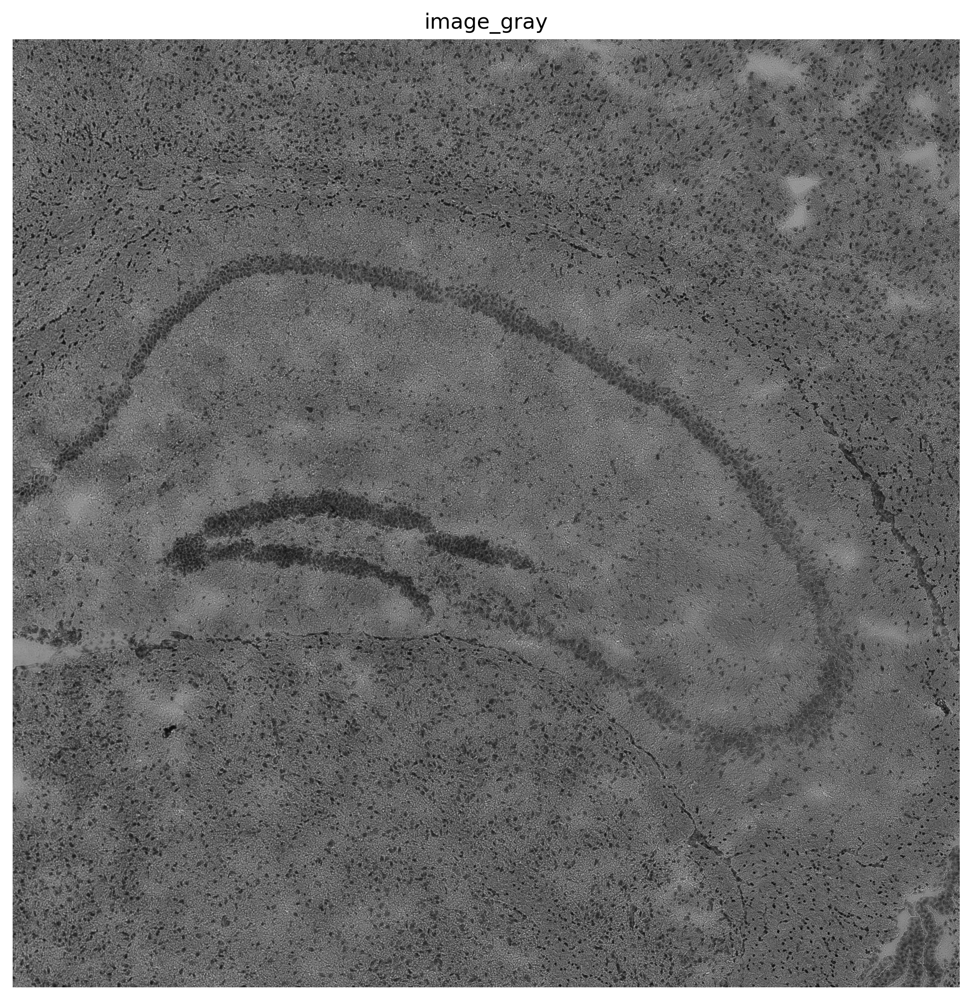

In [4]:
# smooth image
sq.im.process(img, layer="image", method="gray")
img.show("image_gray", dpi=300, save="workflow/hne_gray.png", cmap='gray')

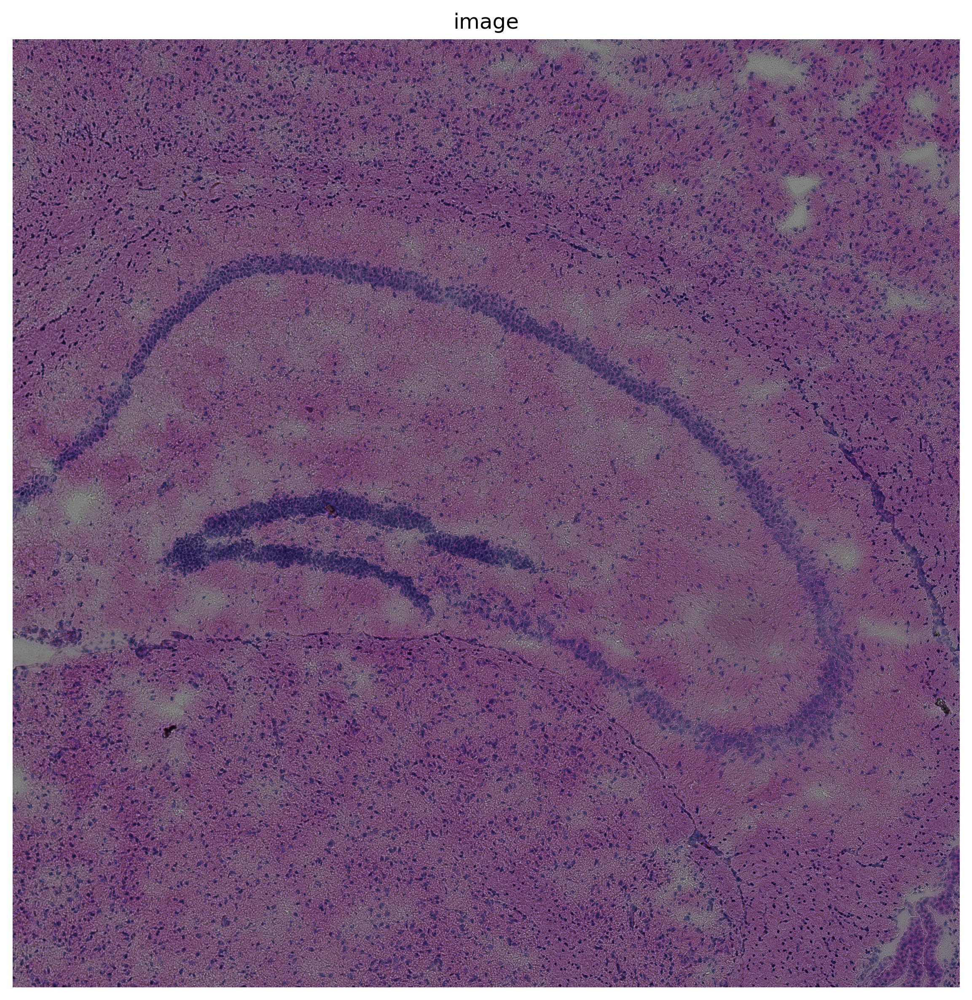

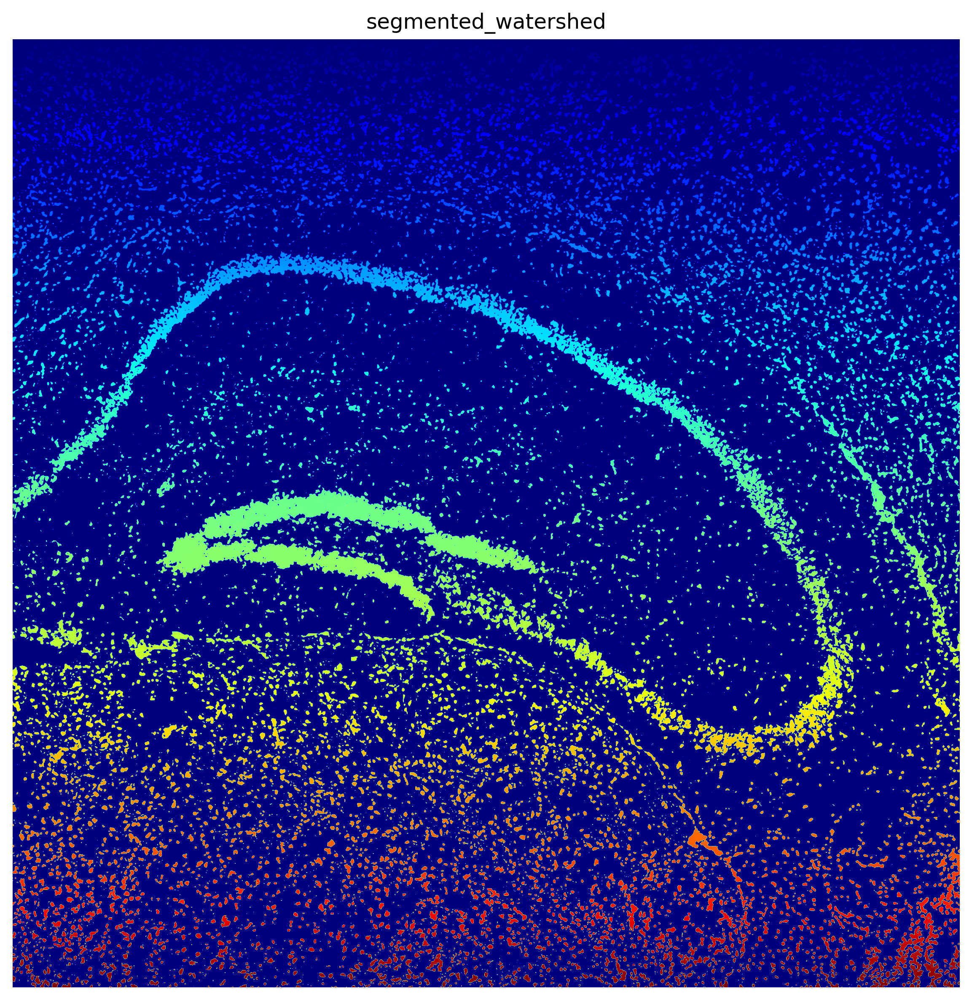

In [5]:
# save images
img.show("image", dpi=300, save="hne_image.png")
# save images
#img.show("image_smooth", dpi=300, save="hne_smooth.png")
# save images
img.show("segmented_watershed", dpi=300, save="workflow/hne_segmented.png", cmap="jet")

## Image features matrix figure

In [6]:
# calculate features
sq.im.calculate_image_features(adata, 
                               img, 
                               layer="image", 
                               key_added='features', 
                               features=['summary', 'segmentation'],
                               n_jobs=4, 
                               spot_scale=1, 
                               scale=1.0, 
                               mask_circle=True, 
                               features_kwargs={'segmentation':{'label_layer':"segmented_watershed"}})

  0%|          | 0/684 [00:00<?, ?/s]

In [7]:
adata.obsm['features']

,segmentation_label,segmentation_area_mean,segmentation_area_std,segmentation_ch-0_mean_intensity_mean,segmentation_ch-0_mean_intensity_std,segmentation_ch-1_mean_intensity_mean,segmentation_ch-1_mean_intensity_std,segmentation_ch-2_mean_intensity_mean,segmentation_ch-2_mean_intensity_std,summary_ch-0_quantile-0.9,...,summary_ch-1_quantile-0.9,summary_ch-1_quantile-0.5,summary_ch-1_quantile-0.1,summary_ch-1_mean,summary_ch-1_std,summary_ch-2_quantile-0.9,summary_ch-2_quantile-0.5,summary_ch-2_quantile-0.1,summary_ch-2_mean,summary_ch-2_std
AAAGACCCAAGTCGCG-1,12,66.833333,66.239255,68.203365,5.453027,48.183760,8.260469,86.983884,13.848657,136.0,...,105.0,71.0,0.0,61.570256,39.142212,138.0,108.0,0.0,88.420906,51.716442
AAAGGGATGTAGCAAG-1,5,9.600000,10.556515,76.147619,9.061773,49.074048,10.093811,80.577143,15.221163,140.0,...,104.0,70.0,0.0,61.294029,38.426191,138.0,103.0,0.0,86.954930,51.650818
AAAGTCACTGATGTAA-1,9,45.444444,46.226763,68.585409,8.416528,54.772485,10.073936,84.913871,6.286752,135.0,...,119.0,89.0,0.0,74.117914,45.040009,138.0,112.0,0.0,90.580987,52.432608
AAATGGCATGTCTTGT-1,11,75.363636,69.544326,71.382414,4.584740,45.423173,4.795686,85.802712,8.097069,134.0,...,96.0,64.0,0.0,55.392753,35.656027,138.0,103.0,0.0,86.517359,51.266960
AAATGGTCAATGTGCC-1,8,47.250000,35.723767,67.897176,6.648240,46.574566,7.407700,86.672906,9.543842,142.0,...,108.0,69.0,0.0,61.870976,39.741225,141.0,106.0,0.0,88.322055,52.049933
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTAATCCGTACTCG-1,23,53.391304,62.831548,70.544600,9.373351,49.926329,7.157145,88.583157,10.096185,139.0,...,106.0,66.0,0.0,59.056180,39.028694,142.0,103.0,0.0,87.344653,52.241279
TTGTATCACACAGAAT-1,13,44.923077,47.243171,74.587117,7.791417,53.083507,5.933278,95.083638,8.242340,135.0,...,99.0,71.0,0.0,60.165383,37.000594,136.0,108.0,0.0,88.080924,51.115047
TTGTCGTTCAGTTACC-1,6,22.333333,21.692293,75.846620,4.662530,57.174598,8.317143,86.858167,16.301971,139.0,...,113.0,80.0,0.0,68.560535,42.391981,138.0,107.0,0.0,88.496149,51.824846
TTGTGGCCCTGACAGT-1,9,44.222222,30.756310,74.868871,7.133937,54.799946,5.876950,96.771210,9.194884,140.0,...,108.0,73.0,0.0,63.634895,39.949966,138.0,106.0,0.0,87.861760,51.500217


In [8]:
# create image crops for obs x features matrix figure
obs_names = adata.obs.index[:10]
crops = []
# make crops slightly larger to make images pretty
for crop in img.generate_spot_crops(adata, obs_names=obs_names, as_array="image", spot_scale=1.1):
    crops.append(crop)

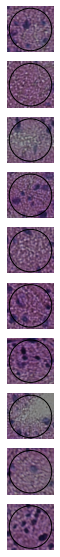

In [9]:
fig,axes = plt.subplots(10,1, figsize=(1,10))
for i,ax in enumerate(axes):
    ax.imshow(crops[i])
    # get position for spot circle
    d = adata.uns['spatial']['V1_Adult_Mouse_Brain']['scalefactors']['spot_diameter_fullres']
    c = crops[i].shape[0]/2
    circle = plt.Circle((c,c), radius=d/2, edgecolor="black", fill=False)
    ax.add_patch(circle)
    ax.axis("off")
plt.savefig('figures/workflow/obs_crops.png', dpi=300)

In [10]:
# plot selected features matrix
features_to_plot = ['segmentation_label', 'summary_ch-0_mean', 'summary_ch-1_mean', 'summary_ch-2_mean', 'segmentation_ch-0_mean_intensity_mean',
       'segmentation_ch-0_mean_intensity_std',
       'segmentation_ch-1_mean_intensity_mean',
       'segmentation_ch-1_mean_intensity_std',
       'segmentation_ch-2_mean_intensity_mean',
       'segmentation_ch-2_mean_intensity_std' ]

features = adata.obsm['features'][features_to_plot].iloc[:10]

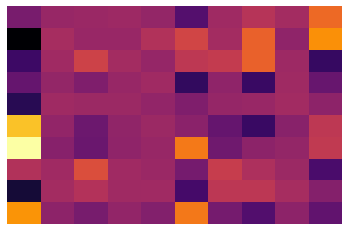

In [11]:
fig, ax = plt.subplots(1,1)
sns.heatmap(features / features.sum(axis=0), cmap='inferno', cbar=False, ax=ax)
ax.axis('off')
plt.savefig('figures/workflow/obs_features_matrix.png', dpi=300)